In [2]:
import networkx as nx
import random
import numpy as np
import pandas as pd
from scipy.spatial import Delaunay
from scipy.spatial.distance import euclidean

def generate_spatial_tissue_network(n, t, k=10, max_distance=None, seed=None):
    """
    Generate a random tissue-like network with spatially placed nodes using Delaunay triangulation,
    with an upper bound distance for creating edges.

    Parameters:
    - n (int): Number of nodes (cells) in the network.
    - t (int): Number of distinct cell types.
    - k (int): The size of the square space (k x k) where nodes are randomly placed.
    - max_distance (float): Maximum distance allowed between two nodes to create an edge.
                            If None, no distance threshold is applied.
    - seed (int): Random seed for reproducibility (default is None).

    Returns:
    - G (networkx.Graph): The generated tissue-like network with cell types as node attributes.
    """
    if seed is not None:
        random.seed(seed)
        np.random.seed(seed)

    # Create a random spatial placement of nodes in a k x k square
    positions = np.random.rand(n, 2) * k  # n points in a 2D space scaled by k

    # Create Delaunay triangulation from these points
    tri = Delaunay(positions)

    # Create a graph
    G = nx.Graph()

    # Add nodes with random cell types
    for i in range(n):
        cell_type = random.randint(0, t-1)  # Random cell type between 0 and t-1
        G.add_node(i, cell_type=cell_type, pos=positions[i])

    # Add edges based on Delaunay triangulation and the distance threshold
    for simplex in tri.simplices:
        for u, v in [(simplex[0], simplex[1]), (simplex[1], simplex[2]), (simplex[2], simplex[0])]:
            dist = euclidean(positions[u], positions[v])  # Calculate Euclidean distance
            if max_distance is None or dist <= max_distance:
                G.add_edge(u, v)

    return G

# Example usage:
n = 10000   # n nodes (cells)
t = 64       # t different cell types
k = 10000   # Size of the square space
max_distance = 500  # Maximum distance allowed between cells for an edge
network = generate_spatial_tissue_network(n=n, t=t, k=k, max_distance=max_distance)

# Print some information about the network
print(f"Number of nodes: {network.number_of_nodes()}")
print(f"Number of edges: {network.number_of_edges()}")

# To visualize positions of nodes
import matplotlib.pyplot as plt

scale_factor=10

pos = nx.get_node_attributes(network, 'pos')
fig, ax = plt.subplots(figsize=(scale_factor * 10, scale_factor * 10))
nx.draw(network, pos, node_color=[network.nodes[i]['cell_type'] for i in network.nodes], with_labels=True, node_size=100, cmap=plt.cm.jet)
plt.show()

Number of nodes: 10000
Number of edges: 29861


In [3]:
import subprocess
from pathlib import Path


def run_fanmod(
        FANMOD_exe: str,
        FANMOD_path: str,
        iterations: str,
        motif_size: int,
        raw_data_folder: str,
        file: str,
        output_dir: str,
        report_filename: str) -> bool:
    try:
        Path(output_dir).mkdir(parents=True, exist_ok=True)
        print(f"{FANMOD_path}/{FANMOD_exe} -i {raw_data_folder}/{file} -o {output_dir}/{report_filename}.csv -r {iterations} -s {motif_size} --colored_vertcies")
        process = subprocess.Popen(f"{FANMOD_path}/{FANMOD_exe} -i {raw_data_folder}/{file} -o {output_dir}/{report_filename}.csv -r {iterations} -s {motif_size} --colored_vertcies")
        process.communicate()
        if process.returncode != 0:
            raise Exception("error occurs while trying to run fanmod+")

        return Path(output_dir + '/' + report_filename + '.csv').exists()
    except FileExistsError as e:
        print(f'{file} failed to create folder {output_dir} error: {e}')
        return False

In [4]:
import pandas as pd

n = 10000   # n nodes (cells)
k = 10000   # Size of the square space
max_distance = 500  # Maximum distance allowed between cells for an edge

path_to_output_dir = './fanmod_benchmark_networks/'
df = None

for colors in [8, 16, 32, 64, 128]:
    for sample_id in range(5):
        G = generate_spatial_tissue_network(n=n, t=colors, k=k, max_distance=max_distance)
        filename = f"n_{n}_k_{k}_t_{colors}_max_distance_{max_distance}_sample_id_{sample_id}.txt"
        with open(f"{path_to_output_dir}{filename}", "w") as f:
            for u, v in G.edges():
                left_node_type = G.nodes[u]['cell_type']
                right_node_type = G.nodes[v]['cell_type']
                f.write(f"{u} {v} {left_node_type} {right_node_type}\n")

        df = pd.concat([df, pd.DataFrame([{'n': n,
                                          'k': k,
                                          't': colors,
                                          'max_distance': max_distance,
                                          'sample_id': sample_id,
                                          'filename': filename,
                                          'nodes': G.number_of_nodes(),
                                          'edges': G.number_of_edges()}])])
df

,n,k,t,max_distance,sample_id,filename,nodes,edges
0,10000,10000,8,500,0,n_10000_k_10000_t_8_max_distance_500_sample_id...,10000,29862
0,10000,10000,8,500,1,n_10000_k_10000_t_8_max_distance_500_sample_id...,10000,29854
0,10000,10000,8,500,2,n_10000_k_10000_t_8_max_distance_500_sample_id...,10000,29862
0,10000,10000,8,500,3,n_10000_k_10000_t_8_max_distance_500_sample_id...,10000,29859
0,10000,10000,8,500,4,n_10000_k_10000_t_8_max_distance_500_sample_id...,10000,29860
0,10000,10000,16,500,0,n_10000_k_10000_t_16_max_distance_500_sample_i...,10000,29858
0,10000,10000,16,500,1,n_10000_k_10000_t_16_max_distance_500_sample_i...,10000,29855
0,10000,10000,16,500,2,n_10000_k_10000_t_16_max_distance_500_sample_i...,10000,29857
0,10000,10000,16,500,3,n_10000_k_10000_t_16_max_distance_500_sample_i...,10000,29853
0,10000,10000,16,500,4,n_10000_k_10000_t_16_max_distance_500_sample_i...,10000,29852


In [5]:
import time

FANMOD_path = "C:\\Users\\User\\source\\repos\\fanmod-cmd\\out\\build\\x64-release"
FANMOD_exe = "LocalFANMOD.exe"

iterations = 100
results = None

for idx, row in df.iterrows():
    for motif_size in [3, 4, 5]:
        if motif_size == 5 and row['t'] > 32:
            continue
        if motif_size == 6 and row['t'] > 16:
            continue
        if motif_size == 7 and row['t'] > 8:
            continue
        if motif_size == 8 and row['t'] > 8:
            continue

        start_time = time.time()
        run_fanmod(
            FANMOD_exe=FANMOD_exe,
            FANMOD_path=FANMOD_path,
            iterations = iterations,
            motif_size=motif_size,
            raw_data_folder=path_to_output_dir,
            file=row['filename'],
            output_dir='./fanmod_benchmark_reports/',
            report_filename=f"motif_size_{motif_size}_{row['filename']}")
        end_time = time.time()
        execution_time = end_time - start_time
        print(f"Execution time: {execution_time:.4f} seconds")
        results = pd.concat([results, pd.DataFrame([{'n': row['n'],
                                                     'k': row['k'],
                                                     't': row['t'],
                                                     'max_distance': row['max_distance'],
                                                     'sample_id': row['sample_id'],
                                                     'nodes': row['nodes'],
                                                     'edges': row['edges'],
                                                     'motif_size': motif_size,
                                                     'iterations': iterations,
                                                     'execution_time': execution_time}])])

C:\Users\User\source\repos\fanmod-cmd\out\build\x64-release/LocalFANMOD.exe -i ./fanmod_benchmark_networks//n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt -o ./fanmod_benchmark_reports//motif_size_3_n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt.csv -r 100 -s 3 --colored_vertcies
Execution time: 8.9751 seconds
C:\Users\User\source\repos\fanmod-cmd\out\build\x64-release/LocalFANMOD.exe -i ./fanmod_benchmark_networks//n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt -o ./fanmod_benchmark_reports//motif_size_4_n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt.csv -r 100 -s 4 --colored_vertcies
Execution time: 61.3008 seconds
C:\Users\User\source\repos\fanmod-cmd\out\build\x64-release/LocalFANMOD.exe -i ./fanmod_benchmark_networks//n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt -o ./fanmod_benchmark_reports//motif_size_5_n_10000_k_10000_t_8_max_distance_500_sample_id_0.txt.csv -r 100 -s 5 --colored_vertcies
Execution time: 644.1709 seconds
C:\Users\User\source\repo

In [8]:
results

,n,k,t,max_distance,sample_id,nodes,edges,motif_size,iterations,execution_time
0,10000,10000,8,500,0,10000,29862,3,100,8.975104
0,10000,10000,8,500,0,10000,29862,4,100,61.300796
0,10000,10000,8,500,0,10000,29862,5,100,644.170854
0,10000,10000,8,500,1,10000,29854,3,100,8.401718
0,10000,10000,8,500,1,10000,29854,4,100,54.318271
...,...,...,...,...,...,...,...,...,...,...
0,10000,10000,128,500,2,10000,29856,4,100,1865.857130
0,10000,10000,128,500,3,10000,29858,3,100,29.977240
0,10000,10000,128,500,3,10000,29858,4,100,1824.760670
0,10000,10000,128,500,4,10000,29859,3,100,30.162256


In [24]:
results[(results['motif_size']==4) & (results['t'] == 128) ].describe()

,n,k,t,max_distance,sample_id,nodes,edges,motif_size,iterations,execution_time
count,2.0,2.0,2.0,2.0,2.000000,2.0,2.00000,2.0,2.0,2.000000
mean,10000.0,10000.0,128.0,500.0,0.500000,10000.0,29857.50000,4.0,100.0,2106.151429
std,0.0,0.0,0.0,0.0,0.707107,0.0,2.12132,0.0,0.0,56.447613
min,10000.0,10000.0,128.0,500.0,0.000000,10000.0,29856.00000,4.0,100.0,2066.236938
25%,10000.0,10000.0,128.0,500.0,0.250000,10000.0,29856.75000,4.0,100.0,2086.194184
50%,10000.0,10000.0,128.0,500.0,0.500000,10000.0,29857.50000,4.0,100.0,2106.151429
75%,10000.0,10000.0,128.0,500.0,0.750000,10000.0,29858.25000,4.0,100.0,2126.108674
max,10000.0,10000.0,128.0,500.0,1.000000,10000.0,29859.00000,4.0,100.0,2146.065919


In [6]:
results.to_csv('./fanmod_plus_bk_test1.csv')

c:\users\user\documents\dev\tnbc_motif\venv\lib\site-packages\seaborn\_base.py:948: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\users\user\documents\dev\tnbc_motif\venv\lib\site-packages\seaborn\_base.py:948: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\users\user\documents\dev\tnbc_motif\venv\lib\site-packages\seaborn\_base.py:948: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


[None]

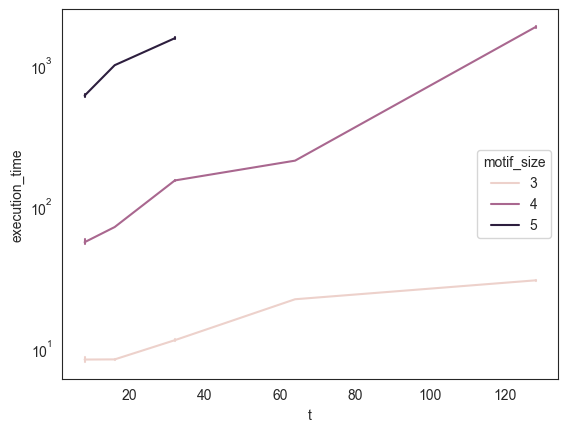

In [7]:
import seaborn as sns

sns.set_style('white')
g_results = sns.lineplot(data=results, x='t', y='execution_time', errorbar=("ci", 95), err_style="bars", hue='motif_size')
g_results.set(yscale='log')